<a href="https://colab.research.google.com/github/LongNguyen1984/TimeSeriesWithPython/blob/main/Visualize_Data1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
import pandas as pd
from pandas import read_csv, DataFrame
import numpy as np

df = read_csv('Device_Codes_session2.csv', header = 5)
df1 = read_csv('session2.csv', header = 0)

In [4]:
df.head()

,Ch : LED 2,Ch : LED 3,Ch : LED 1,Ch : LED 1 AMBIENT
0,5,5,125,5
1,51,51,1382,51
2,278,278,7483,279
3,1002,1001,26721,1002
4,2704,2701,71574,2697


In [ ]:
import seaborn as sns

col_dict = {1:'#7bc90c',
            -1:'#ffb700',
            3:'#f5072f',
            4:'#d109e3',
            5: "#009dff",
            6: "#10ccb6",
            0: "#6484f5",
            8: "#ab0e3a",
            9: "#bd9e15",
            7: 'grey',
           }

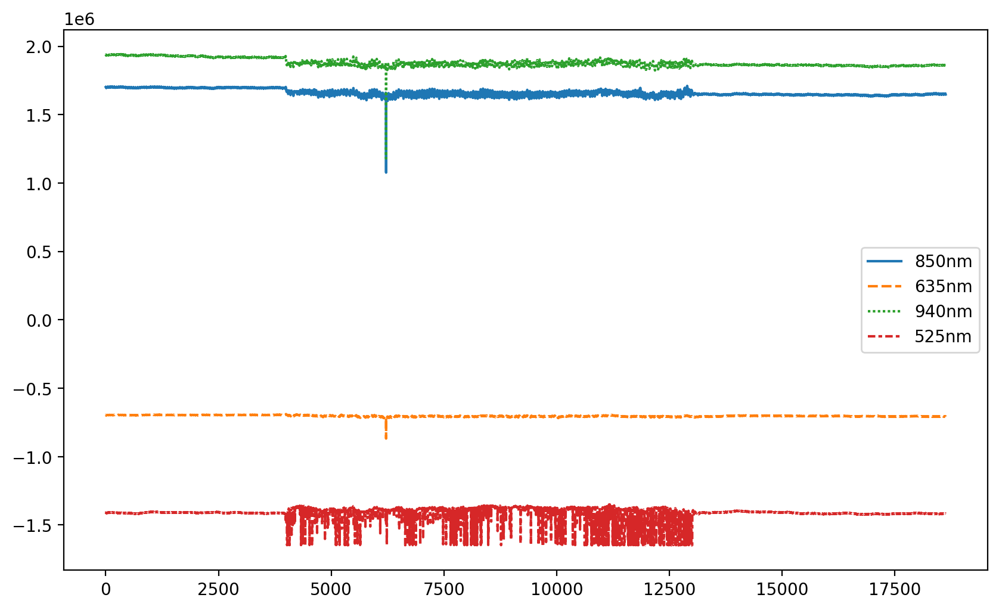

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 6), dpi = 200)

sns.lineplot(data = df)

In [ ]:
pip install mpld3

     |████████████████████████████████| 1.0 MB 8.1 MB/s 
  Created wheel for mpld3: filename=mpld3-0.5.5-py3-none-any.whl size=200907 sha256=28cde36548868eb72b316ec1352badc5ce63b064662a2f61b39f356f8fa608c8
  Stored in directory: /root/.cache/pip/wheels/3b/f3/08/a11447ac4ea31d7603142e76b4cba9e48b2fa7d82b76b69731
Successfully built mpld3


In [6]:
import plotly.express as px
#df = read_csv('PPGfist1.csv', header = 0)
df['id'] = [x/250 for x in range(1, len(df.values)+1)]
#df.index.name = 'id'
df.head()



,Ch : LED 2,Ch : LED 3,Ch : LED 1,Ch : LED 1 AMBIENT,id
0,5,5,125,5,0.004
1,51,51,1382,51,0.008
2,278,278,7483,279,0.012
3,1002,1001,26721,1002,0.016
4,2704,2701,71574,2697,0.020


### Resampling data from 250 to 70

In [25]:
from scipy import signal

old_fs = 250
new_fs = 70
N = len(df)//old_fs*new_fs
df_rsp = signal.resample(df, N)
df_rsp =pd.DataFrame(df_rsp[:,:-1], columns=['630nm', '940nm','530nm','amb'])
df_rsp['id'] = [x/70 for x in range(1, len(df_rsp.values)+1)]

In [26]:
df_rsp.head()

,630nm,940nm,530nm,amb,id
0,195831.333374,107087.871495,1.138119e+05,860.465742,0.014286
1,-43305.972221,-22865.398289,2.196673e+04,1604.413634,0.028571
2,43361.585361,32115.164806,4.991233e+05,18581.413613,0.042857
3,29896.743158,37145.510405,1.174448e+06,45224.542112,0.057143
4,67574.357032,61453.378504,1.374242e+06,52615.616178,0.071429


In [27]:
import plotly.express as px
import pandas as pd


fig = px.line(df_rsp, x="id", y='630nm') 
fig.show()



In [28]:
import pandas as pd

#path = 'drive/Shareddrives/AIOT_LAB_DOCS/Data/MAData/'

#df = pd.read_csv(path +'PPGthumb1.csv', header = 0)
df1['id'] = [x/70 for x in range(1, len(df1.values)+1)]
#df.index.name = 'id'
df1.head()


,850nm,635nm,940nm,525nm,id
0,1356440.0,-853254.0,974923.0,-1432860.0,0.014286
1,1357390.0,-853158.0,975467.0,-1431790.0,0.028571
2,1356810.0,-853023.0,975480.0,-1432500.0,0.042857
3,1357490.0,-852829.0,975723.0,-1431640.0,0.057143
4,1357690.0,-852583.0,976371.0,-1432050.0,0.071429


In [30]:
import plotly.graph_objects as go

# Create traces
fig = go.Figure()
fig.add_trace(go.Scatter(x=df1['id'], y=df1['850nm'],
                    mode='lines',
                    name='850nm'))
fig.add_trace(go.Scatter(x=df1['id'], y=df1['635nm'],
                    mode='lines',
                    name='630nm'))

fig.add_trace(go.Scatter(x=df1['id'], y=df1['940nm'],
                    mode='lines',
                    name='940nm'))

fig.add_trace(go.Scatter(x=df1['id'], y=df1['525nm'],
                    mode='lines',
                    name='525'))

fig.update_layout(margin=dict(l=100, r=100,b=100,t=100), width=1200, height=800)
fig.update_layout(title='PPG data',
                   xaxis_title='Samples',
                   yaxis_title='Amplitude')
#fig.add_trace(go.Scatter(x=random_x, y=random_y1, mode='lines+markers', name='lines+markers'))
#fig.add_trace(go.Scatter(x=random_x, y=random_y2, mode='markers', name='markers'))
fig.show()

In [33]:
#df1.columns.values[0]
fig = go.Figure()
signals = [x for x in df1.columns.values if x != 'Time' and x != 'id']
for sig in signals:
  fig.add_trace(go.Scatter(x=df1['id'], y=df1[sig],
                    mode='lines',
                    name=sig))


fig.update_layout(margin=dict(l=100, r=100,b=100,t=100), width=1200, height=800)
fig.update_layout(title='PPG left data',
                   xaxis_title='Time',
                   yaxis_title='Amplitude')

### Display FFT

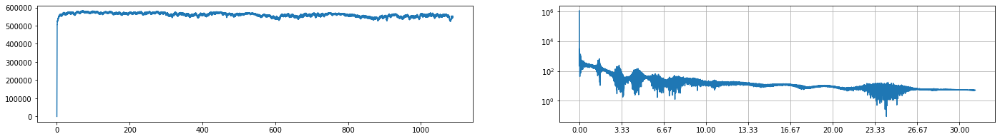

In [69]:
from scipy import pi
import matplotlib.pyplot as plt
from scipy.fftpack import fft,fftfreq
# Number of sample points
N = np.shape(df)[0]
fs = 250
# sample spacing
T = 1.0 /fs
#y = df['Ch : LED 2'].values

x = np.linspace(0.0, N*T, N, endpoint=False)
y = df['Ch : LED 2'].values
yf = fft(y)
xf = fftfreq(N, T)[:N//2]

plt.figure(figsize=(24,3))

plt.subplot(1,2,1)
plt.plot (x,y)

plt.subplot(1,2,2)
L1, L2 = 0, 30
plt.plot(xf[:N//8], 2.0/N * np.abs(yf[:N//8]))
plt.xticks(np.linspace(L1, L2, 10) )
plt.yscale('log')
plt.grid()

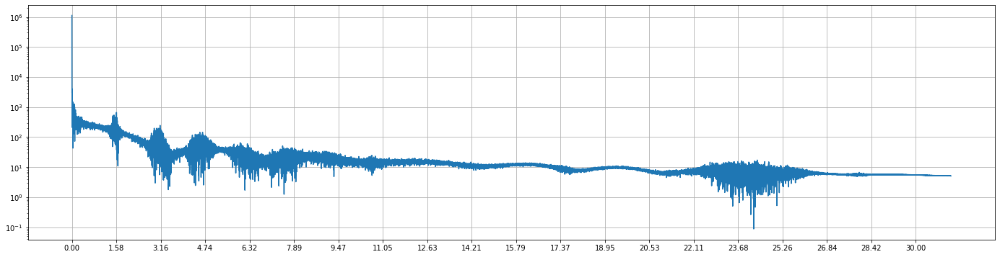

In [70]:
plt.figure(figsize=(24,6))
L1, L2 = 0, 30
plt.plot(xf[:N//8], 2.0/N * np.abs(yf[:N//8]))
plt.xticks( np.linspace(L1, L2, 20) )
plt.yscale('log')
plt.grid()

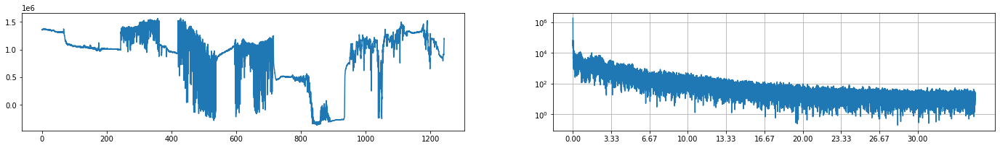

In [83]:
N1 = np.shape(df1)[0]
fs1 = 70
# sample spacing
T1 = 1.0 /fs1
#y = df['Ch : LED 2'].values

x1 = np.linspace(0.0, N1*T1, N1, endpoint=False)
y1 = df1['850nm'].values
yf1 = fft(y1)
xf1 = fftfreq(N1, T1)[:N1//2]

plt.figure(figsize=(24,3))

plt.subplot(1,2,1)
plt.plot (x1,y1)

plt.subplot(1,2,2)
L1, L2 = 0, 30
plt.plot(xf1[:N1//2], 2.0/N1 * np.abs(yf1[:N1//2]))
plt.xticks(np.linspace(L1, L2, 10) )
plt.yscale('log')
plt.grid()

In [119]:
import plotly.graph_objects as go
#from plotly.subplots import make_subplots
#fig = make_subplots(rows=1, cols=2, subplot_titles=("Default Scale", "Logarithmic Scale"))
plt.figure(figsize=(24,6))
L1,L2=0,35000
# Create traces
fig = go.Figure()
fig.add_trace(go.Scatter(x=xf[L1:L2], y=2.0/N * np.abs(yf[L1:L2]),
                    mode='lines',
                    name='850nm'))

fig.add_trace(go.Scatter(x=xf1[L1:L2], y=2.0/N1 * np.abs(yf1[L1:L2]),
                    mode='lines',
                    name='850nm'))
#fig.update_xaxes(title_text="x-axis in default scale", type='log')
fig.update_yaxes(title_text="y-axis in default scale", type='log')


fig.update_layout(margin=dict(l=100, r=100,b=100,t=100), width=1200, height=800)
fig.update_layout(title='PPG Spectrum',
                   xaxis_title='Frequency (Hz)',
                   yaxis_title='Magnitude')

<Figure size 1728x432 with 0 Axes>

## Spectral Gram

In [ ]:
def specgram2d(y, srate=44100, ax=None, title=None):
  if not ax:
    ax = plt.axes()
    ax.set_title(title, loc='center', wrap=True)
    spec, freqs, t, im = ax.specgram(y, Fs=fs, scale='dB', vmax=0)
    ax.set_xlabel('time (s)')
    ax.set_ylabel('frequencies (Hz)')
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('Amplitude (dB)')
    cbar.minorticks_on()
    return spec, freqs, t, im


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:25: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



<Figure size 1728x216 with 0 Axes>

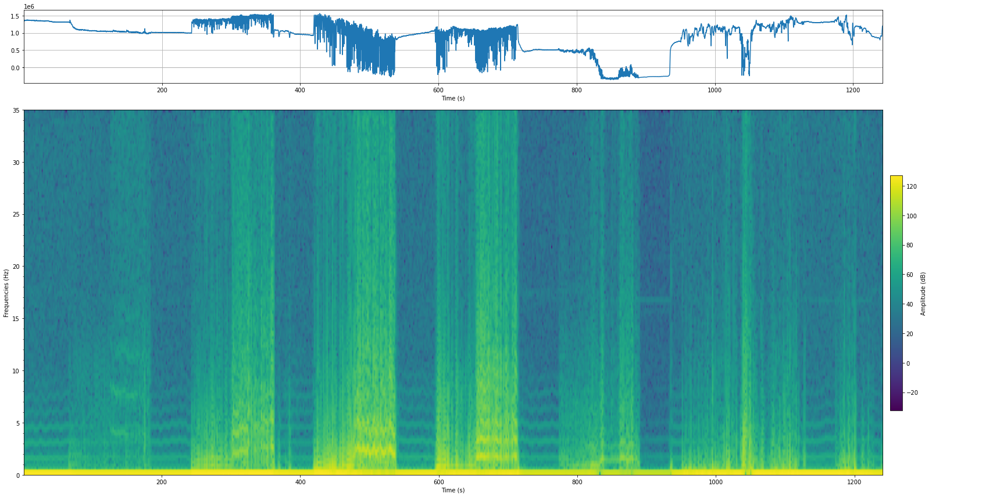

In [118]:
from matplotlib.ticker import AutoMinorLocator
# plot it
plt.figure(figsize=(24,3))
f, ax = plt.subplots(2, 2, gridspec_kw={'height_ratios': [1, 5], 'width_ratios': [8, 1]}, figsize=(24,12))

ax[0][1].axis('off')
ml = AutoMinorLocator(5)
ax[0][0].plot(df1['id'],df1['850nm'].values)
ax[0][0].set_xlabel('Time (s)')
ax[0][0].yaxis.set_minor_locator(ml)
#ax[0][0].xaxis.set_minor_locator(ml)
ax[0][0].grid(which='both')
ax[0][0].margins(x=0)

#plt.grid(True)
spec, freqs, t, im = ax[1][0].specgram(df1['850nm'].values, Fs=70) #cmap="rainbow"
ax[1][0].yaxis.set_minor_locator(ml)
ax[1][0].set_xlabel('Time (s)')
ax[1][0].set_ylabel('Frequencies (Hz)')

ax[1][1].axis('off')
cbar = plt.colorbar(im, ax=[ax[1][1]], location='right')
cbar.set_label('Amplitude (dB)')

f.tight_layout()